In [1]:
%matplotlib notebook

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import statsmodels.formula.api as smf
import os, math
from statsmodels.tsa.stattools import grangercausalitytests
from statsmodels.tsa.vector_ar.vecm import coint_johansen
import seaborn as sns
from statsmodels.tsa.api import VAR
from statsmodels.tsa.stattools import adfuller
from statsmodels.tools.eval_measures import rmse, aic
from statsmodels.stats.stattools import durbin_watson
import warnings
warnings.filterwarnings('ignore')
np.random.seed(0)

%matplotlib inline





# UTILITY OBJECTS

In [2]:
subsample_countries = ["KOR","GBR","ESP","JPN","CAN","USA","MEX","DEU","ITA","CHE","SWE","FRA"]
dates_processor = lambda x: "{}-01-{}".format(int(x.split("-")[1][1])*3, x.split("-")[0])

In [3]:
def get_connectedness(data, order, pvalue_cutoff = None, var_decomposition_order =2):
    
    num_iterations = 100
    original_order = data.columns
    rolling_ordering = False
    connectedness_aggregate = {}    
    for i in range(num_iterations):
        np.random.seed(i)
        
        if rolling_ordering:
            data = data.reindex(columns=np.roll(original_order, i+1, axis = None))
        else:
            data = data.reindex(columns=np.random.permutation(data.columns))
        
        model = VAR(data).fit(order)
        
        connectedness = model.fevd(var_decomposition_order).result()[:,var_decomposition_order-1,:]
        np.fill_diagonal(connectedness,0)
        
        if pvalue_cutoff is not None:
            p_values = model.pvalues[1:]
            p_values = np.mean(np.array([(p_values[i*12:(i+1)*12].T).values for i in range(p_values.shape[0]/12)]), axis=0)
            connectedness[p_values[i]> pvalue_cutoff] = 0
        connectedness_aggregate[i] = pd.DataFrame(connectedness, columns = data.columns, index = data.columns)
    connectedness_aggregate = pd.Panel(connectedness_aggregate).mean(axis=0)
    connectedness_aggregate.index = connectedness_aggregate.index.set_names('country')
    return connectedness_aggregate

def expanding_var(data, order, start, pvalue_cutoff = None, var_decomposition_order =2):
    networks = []
    forecasts = pd.DataFrame(columns = data.columns, index = data[start-1:].index)
    for idx,t in enumerate(range(start, data.shape[0])):
        network = get_connectedness(data[:t], order, pvalue_cutoff = pvalue_cutoff, var_decomposition_order =var_decomposition_order)
        network = pd.concat([network], keys=[data[:t].index.max()], names=['date'])
        networks.append(network)
        
    return pd.concat(networks).swaplevel(0,1, axis=0)

In [4]:
def heatmap_comparison(net_5,net_50, plot_name):
    dates = pd.to_datetime(['2008-03-01','2008-06-01','2008-09-01','2008-12-01','2009-03-01','2009-06-01','2009-9-01','2009-12-01'])
    fig, axs = plt.subplots(8, 2, figsize = (25, 85))
    for i,d in enumerate(dates):
        adj_5 = net_5.xs(d, level=1, drop_level=True).round(2)
        adj_50 = net_50.xs(d, level=1, drop_level=True).round(2)

        minn, maxx = min(adj_5.min().min(),adj_50.min().min()), max(adj_5.max().max(),adj_50.max().max())
        sns.heatmap(adj_5, annot=True, center=0, cmap = sns.color_palette("coolwarm", 7),ax = axs[i, 0],vmin = minn ,vmax= maxx )
        sns.heatmap(adj_50, annot=True, center=0, cmap = sns.color_palette("coolwarm", 7),ax = axs[i, 1],vmin = minn ,vmax= maxx )

        axs[i,0].set_title("5th Quantile on {}".format(d.strftime("%b %Y")))
        axs[i,1].set_title("50th Quantile on {}".format(d.strftime("%b %Y")))
    plt.tight_layout(pad=3.0)
    plt.savefig('graphs/{}_Network_Heatmap.png'.format(plot_name))

In [5]:
def plot_difference(net_5,net_50, gdp, ylabel, plot_name, instantaneous = False):
    fig, axs = plt.subplots(4, 3, figsize = (25, 20))
    fig.suptitle(plot_name.replace('_',' ').upper(), fontsize=30, y = 1.0)
    
    for i, country in enumerate(subsample_countries):
        gap_single_country = net_50.xs(country, level=0, drop_level=True).drop([country], axis=1) - net_5.xs(country, level=0, drop_level=True).drop([country], axis=1)
        if instantaneous:
            gap_single_country = gap_single_country.diff().dropna()
        
        gdp_single_country = gdp.loc[gdp.index.isin(gap_single_country.index)][country]

        axs[i/3, i%3].plot(gap_single_country.index,gap_single_country.max(axis=1)-gap_single_country.min(axis=1), label = 'Range', linewidth=2)
        axs[i/3, i%3].plot(gap_single_country.index,gap_single_country.abs().sum(axis=1), label = 'Sum', linewidth=2)
        axs[i/3, i%3].plot(gap_single_country.index,gap_single_country.mean(axis=1),label = 'Mean', linewidth=2)
        axs[i/3, i%3].plot(gap_single_country.index,gap_single_country.mean(axis=1),label = 'Deviation', linewidth=2)

        axs[i/3, i%3].set_title(country, fontsize = 18)
        axs[i/3, i%3].legend(loc='upper left')
                
        axs[i/3, i%3].set_xlabel("Quarters", fontsize = 13)
        axs[i/3, i%3].set_ylabel(ylabel, fontsize = 13)
  
        secondary_axis = axs[i/3, i%3].twinx()
        secondary_axis.plot(gdp_single_country.index, gdp_single_country, linewidth=1, label = 'Realized GDP', c='k', linestyle=':')
        secondary_axis.set_ylabel("GDP Growth Rate", fontsize = 13)
        secondary_axis.legend(loc='upper right')
        
    plt.tight_layout(pad=3.0)
    plt.savefig('graphs/{}_Network.png'.format(plot_name))

In [6]:
def plot_net_stats(net_5,net_50,gdp, ylabel, plot_name, ptype = None):
    fig, axs = plt.subplots(4, 3, figsize = (25, 20))
    fig.suptitle(plot_name.replace('_',' ').upper(), fontsize=30, y = 1.0)

    for i, country in enumerate(subsample_countries):
        net_5_single_country = net_5.xs(country, level=0, drop_level=True).drop([country], axis=1).diff().dropna()
        net_50_single_country = net_50.xs(country, level=0, drop_level=True).drop([country], axis=1).diff().dropna()
        gdp_single_country = gdp.loc[gdp.index.isin(net_50_single_country.index)][country]
        
        if ptype == 'range':
            net_5_single_country, net_50_single_country = net_5_single_country.max(axis=1)-net_5_single_country.min(axis=1), net_50_single_country.max(axis=1)-net_50_single_country.min(axis=1)
        if ptype == 'mean':
            net_5_single_country, net_50_single_country = net_5_single_country.mean(axis=1), net_50_single_country.mean(axis=1)
        if ptype == 'sum':
            net_5_single_country, net_50_single_country = net_5_single_country.abs().sum(axis=1), net_50_single_country.abs().sum(axis=1)
        if ptype == 'std':
            net_5_single_country, net_50_single_country = net_5_single_country.abs().sum(axis=1), net_50_single_country.std(axis=1)
        if ptype == 'skew':
            net_5_single_country, net_50_single_country = net_5_single_country.abs().sum(axis=1), net_50_single_country.skew(axis=1)
            
        axs[i/3, i%3].plot(net_5_single_country.index, net_5_single_country, linewidth=1, label = 'Fifth Quantile')
        axs[i/3, i%3].plot(net_50_single_country.index, net_50_single_country, linewidth=1, label = 'Fiftieth Quantile')
        
        axs[i/3, i%3].set_title(country, fontsize = 20)
        axs[i/3, i%3].set_xlabel("Quarters", fontsize = 11)
        axs[i/3, i%3].set_ylabel(ylabel, fontsize = 11)
        axs[i/3, i%3].legend(bbox_to_anchor=(1, 1), loc='upper left', borderaxespad=0.)
        axs[i/3, i%3].legend(loc='upper left')

        secondary_axis = axs[i/3, i%3].twinx()
        secondary_axis.plot(gdp_single_country.index, gdp_single_country, linewidth=1, label = 'Realized GDP', c='k', linestyle=':')
        secondary_axis.set_ylabel("GDP Growth Rate", fontsize = 11)
        secondary_axis.legend(loc='upper right')

    plt.tight_layout(pad=3.0)
    plt.savefig('graphs/{}_Network.png'.format(plot_name))

In [7]:
def plot_net(net_5,net_50, ylabel, plot_name, instantaneous = False):
    fig, axs = plt.subplots(12, 2, figsize = (25, 80))
    fig.suptitle(plot_name.replace('_',' ').upper(), fontsize=30, y = 1.0)
    
    for i, home in enumerate(subsample_countries):
        net_5_single_country = net_5.xs(home, level=0, drop_level=True).drop([home], axis=1)
        net_50_single_country = net_50.xs(home, level=0, drop_level=True).drop([home], axis=1)
        
        if instantaneous:
            net_5_single_country, net_50_single_country = net_5_single_country.diff().dropna(), net_50_single_country.diff().dropna()
        
        net_5_single_country.plot(ax = axs[i, 0], linewidth=1)
        net_50_single_country.plot(ax = axs[i, 1], linewidth=1)
        
        minn, maxx = pd.concat([net_5_single_country, net_50_single_country]).min().min(), pd.concat([net_5_single_country, net_50_single_country]).max().max()


        axs[i, 0].set_title("5th Quantile [{}]".format(home), fontsize = 18)
        axs[i, 1].set_title("50th Quantile [{}]".format(home), fontsize = 18)
        
        axs[i, 0].set_xlabel("Quarters", fontsize = 13)
        axs[i, 0].set_ylabel(ylabel, fontsize = 13)
        axs[i, 1].set_xlabel("Quarters", fontsize = 13)
        axs[i, 1].set_ylabel(ylabel, fontsize = 13)

        axs[i, 0].legend(bbox_to_anchor=(1, 1), loc='upper left', borderaxespad=0.)
        axs[i, 1].legend(bbox_to_anchor=(1, 1), loc='upper left', borderaxespad=0.)

        axs[i, 0].set_ylim(minn, maxx)
        axs[i, 1].set_ylim(minn, maxx)
        
    plt.tight_layout(pad=3.0)
    plt.savefig('graphs/{}_Network.png'.format(plot_name))

In [8]:
def load_data(path):
    data = pd.read_csv(path, index_col=0)
    data.index = pd.to_datetime(data.index)
    return data

In [9]:
gdp = pd.read_csv("../data/core/oecd_qrgdp.csv")

gdp = gdp.pivot(index='TIME', columns='LOCATION', values='Value')
gdp.index  = pd.to_datetime(gdp.index.map(dates_processor))
gdp = gdp[subsample_countries]

gdp.dropna(inplace = True)

# ORDER ONE VECTOR-AUTO-REGRESSION

In [10]:
net_5 = expanding_var(load_data("../data/gdp QF4/5.csv")[subsample_countries], order=1,start=60)
net_50 = expanding_var(load_data("../data/gdp QF4/50.csv")[subsample_countries], order=1,start=60)

net_5.to_csv("../data/networks/Q5F4O1.csv")
net_50.to_csv("../data/networks/Q50F4O1.csv")

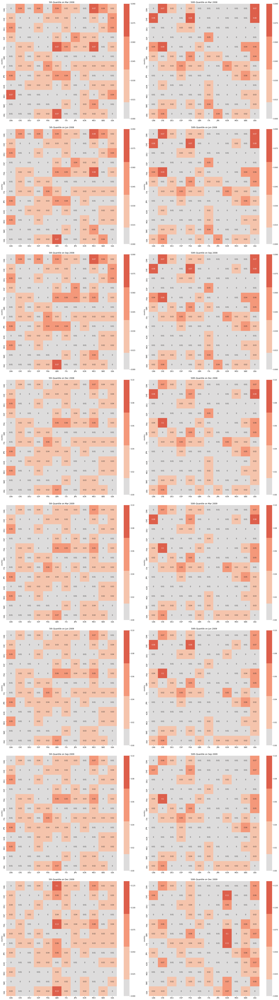

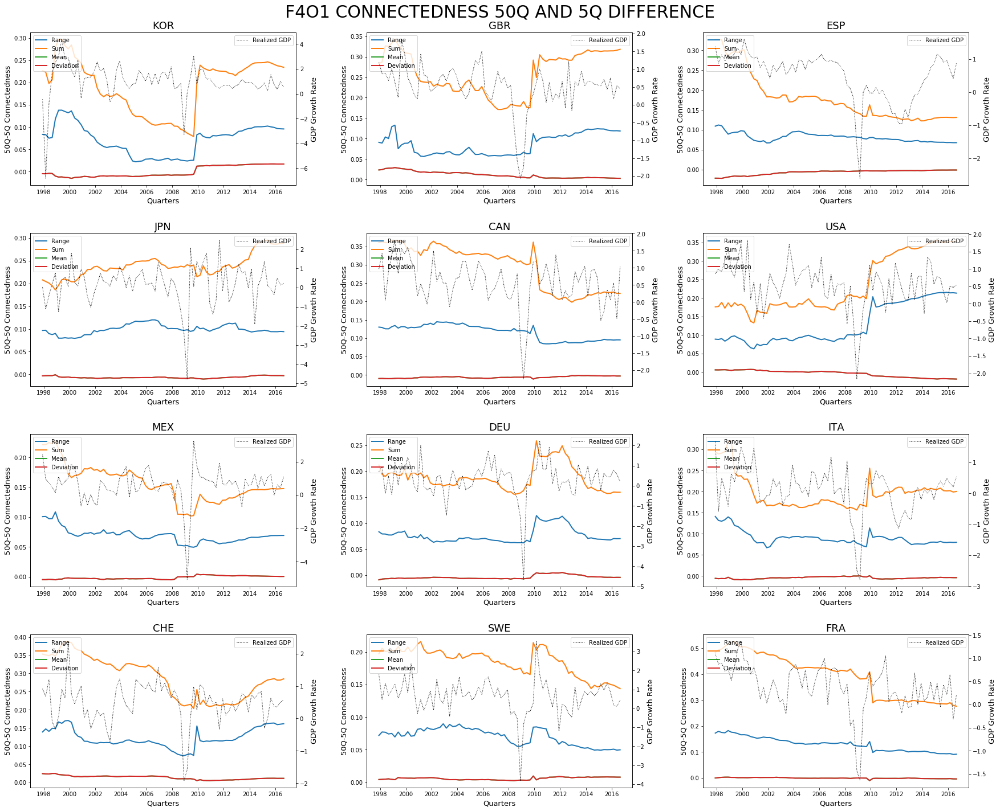

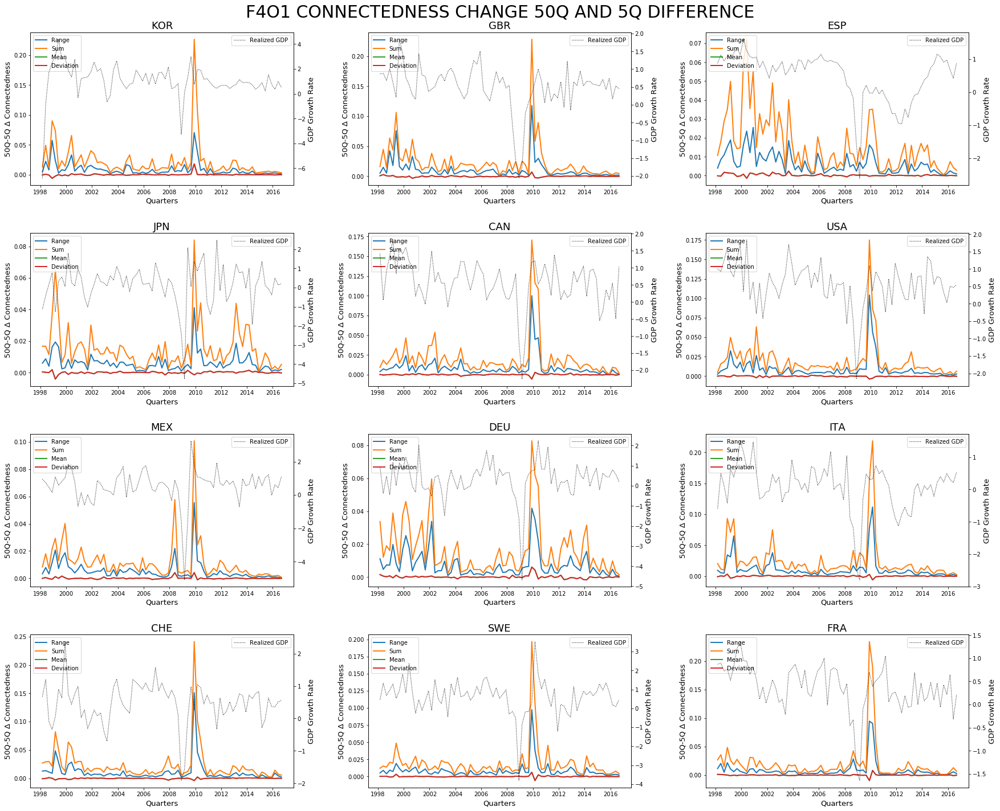

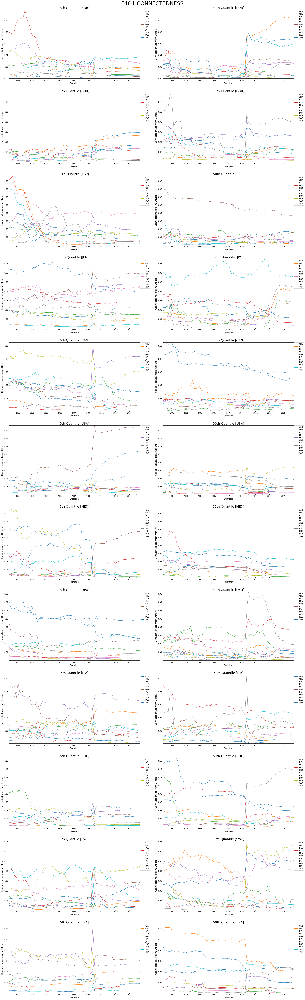

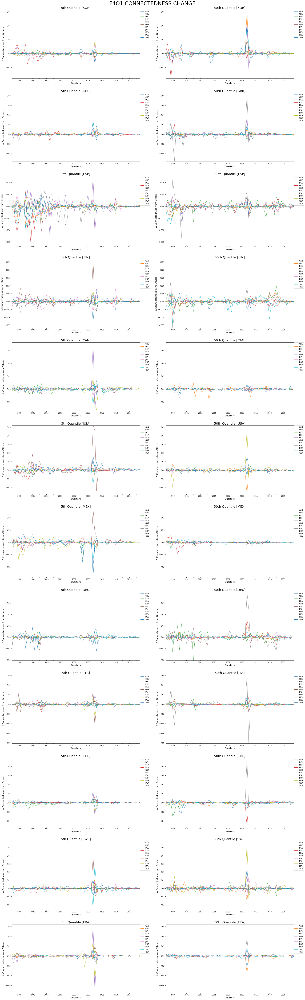

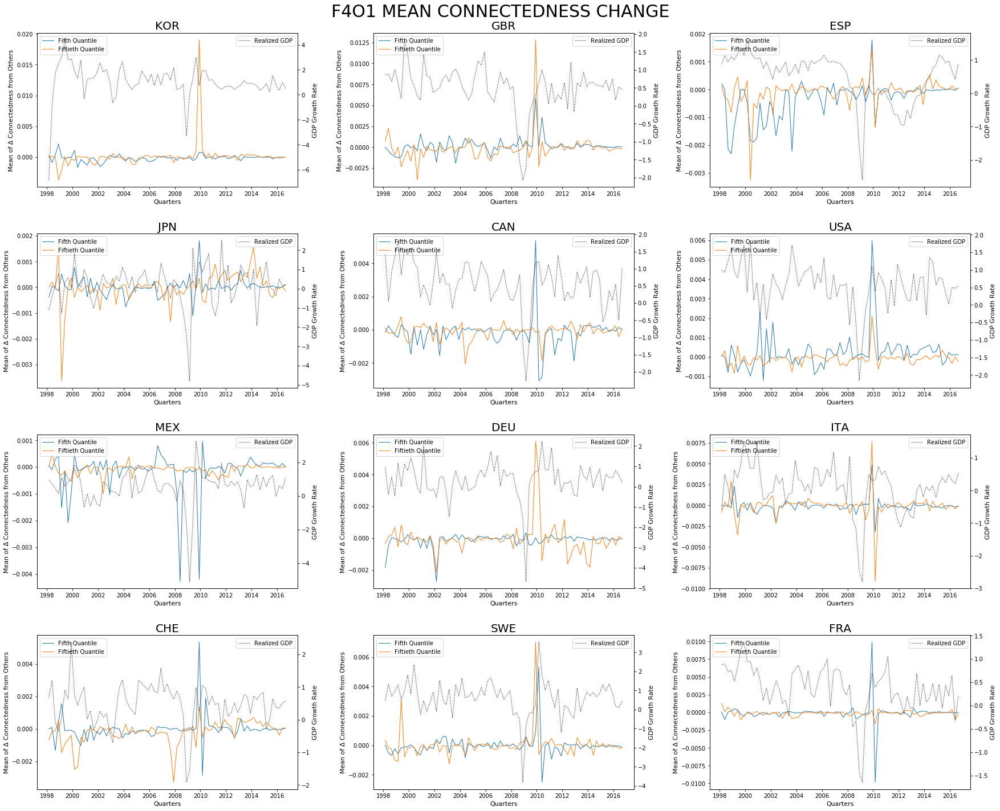

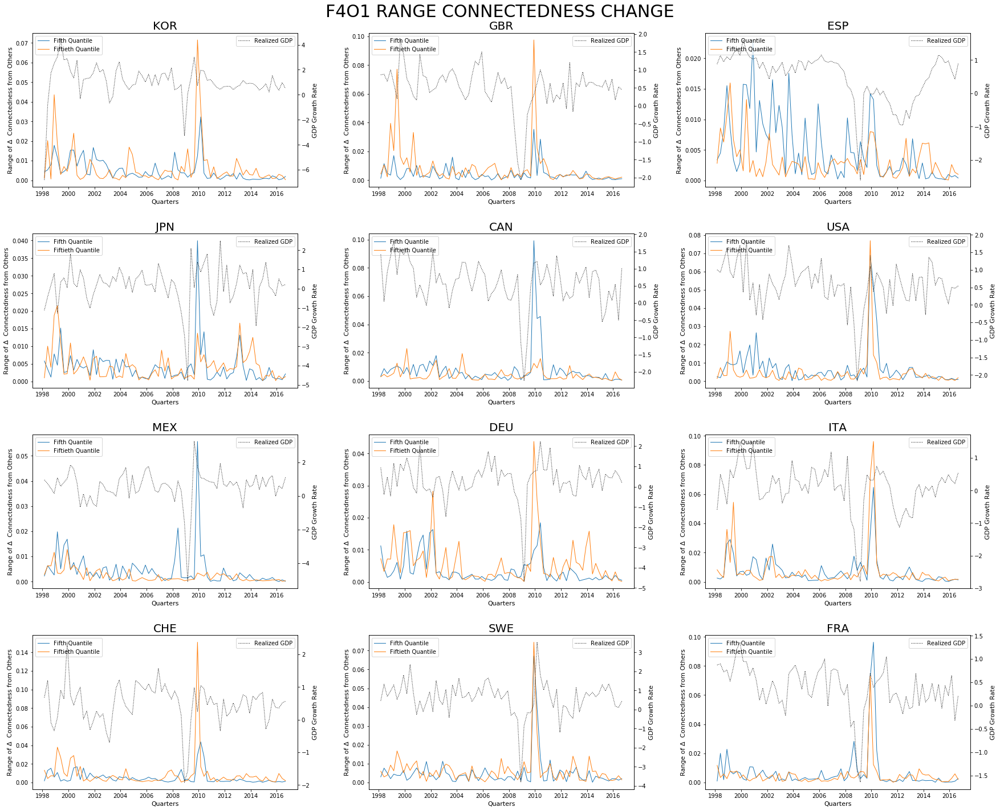

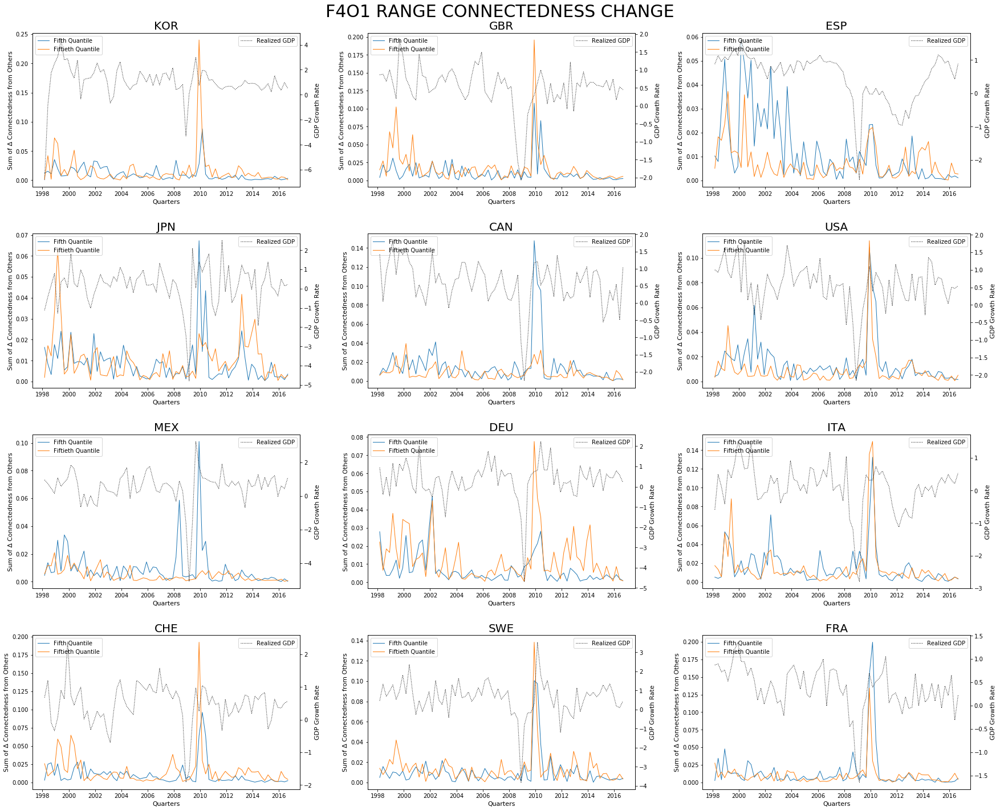

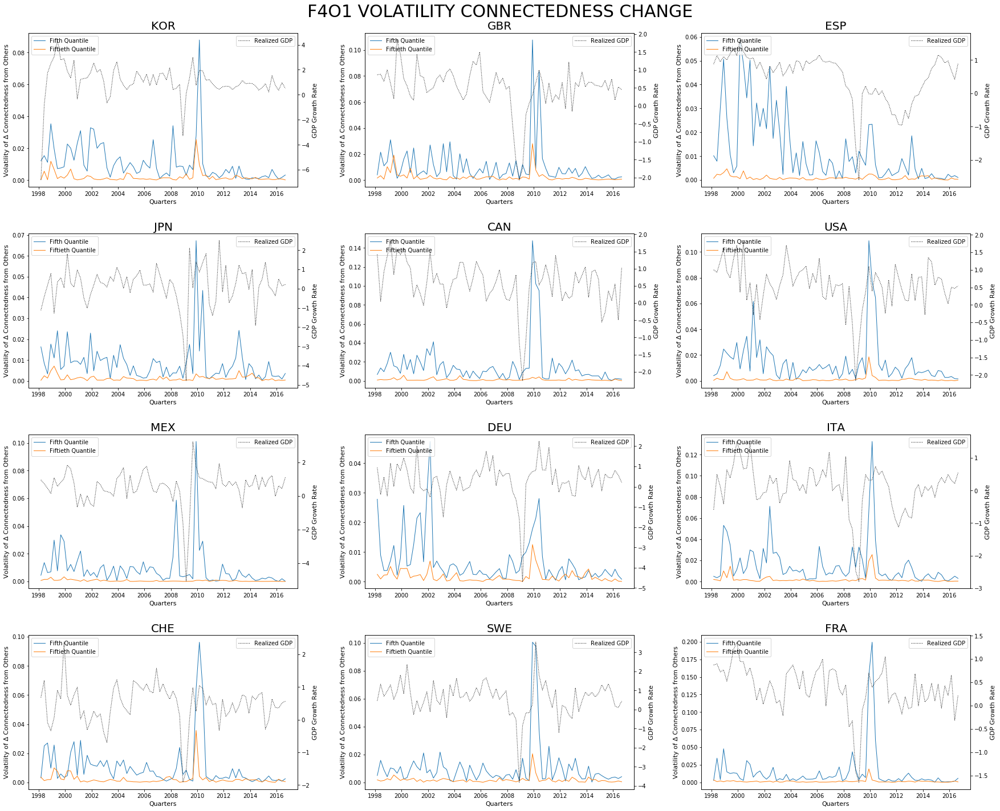

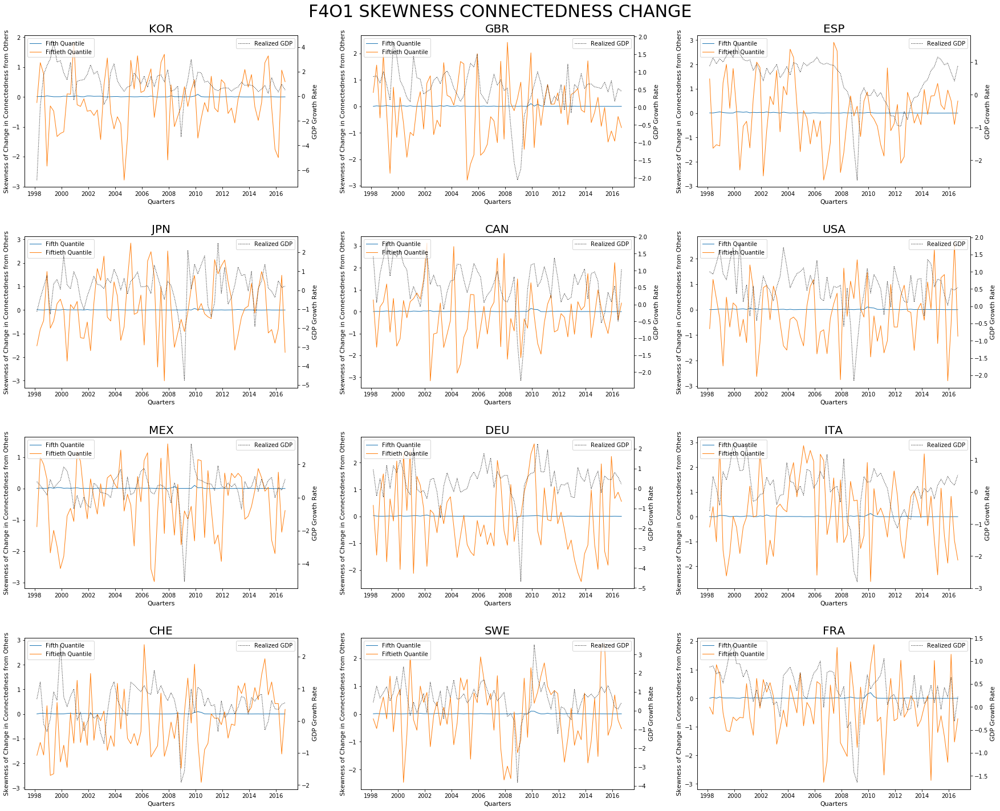

In [11]:
heatmap_comparison(net_5,net_50, 'F4O1_connectedness_heatmap_visualization')
plot_difference(net_5,net_50, gdp, u'50Q-5Q Connectedness', 'F4O1_connectedness_50q_and_5q_difference', instantaneous = False)
plot_difference(net_5,net_50, gdp, u'50Q-5Q Δ Connectedness', 'F4O1_connectedness_change_50q_and_5q_difference', instantaneous = True)
plot_net(net_5,net_50, u"Connectedness from Others", 'F4O1_connectedness', instantaneous = False)
plot_net(net_5,net_50, u"Δ Connectedness from Others", 'F4O1_connectedness_change', instantaneous = True)
plot_net_stats(net_5,net_50, gdp, u'Mean of Δ Connectedness from Others', 'F4O1_mean_connectedness_change', ptype = 'mean')
plot_net_stats(net_5,net_50, gdp, u'Range of Δ  Connectedness from Others', 'F4O1_range_connectedness_change', ptype = 'range')
plot_net_stats(net_5,net_50, gdp, u'Sum of Δ Connectedness from Others', 'F4O1_range_connectedness_change', ptype = 'sum')
plot_net_stats(net_5,net_50, gdp, u'Volatility of Δ Connectedness from Others', 'F4O1_volatility_connectedness_change', ptype = 'std')
plot_net_stats(net_5,net_50, gdp, u'Skewness of Change in Connectedness from Others', 'F4O1_skewness_connectedness_change', ptype = 'skew')

# ORDER FOUR VECTOR-AUTO-REGRESSION

In [12]:
net_5 = expanding_var(load_data("../data/gdp QF4/5.csv")[subsample_countries], order=4,start=80)
net_50 = expanding_var(load_data("../data/gdp QF4/50.csv")[subsample_countries], order=4,start=80)

net_5.to_csv("../data/networks/Q5F4O4.csv")
net_50.to_csv("../data/networks/Q50F4O4.csv")

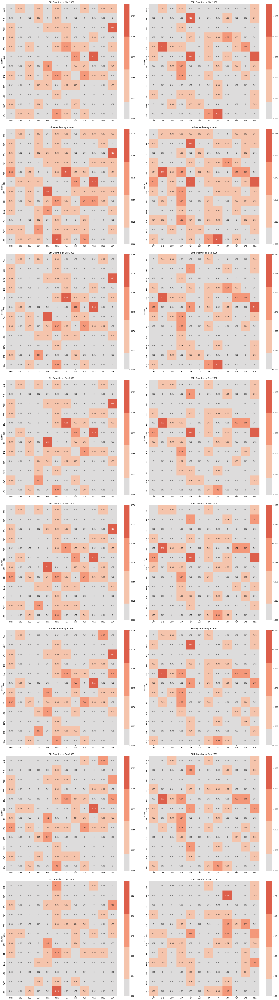

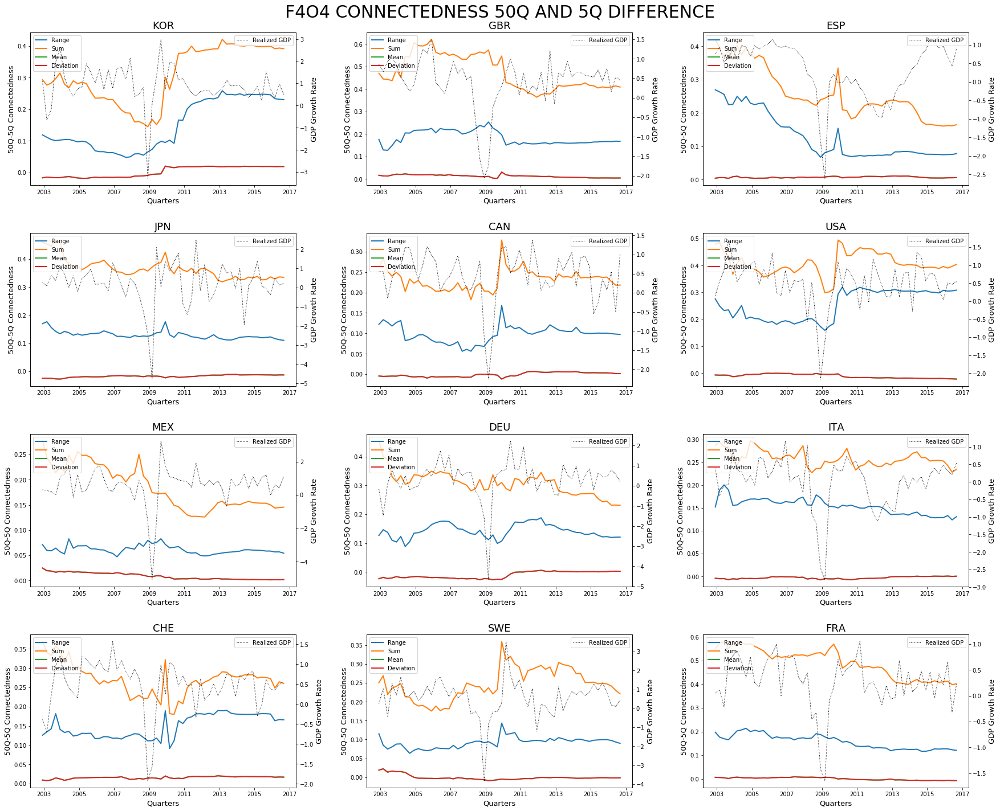

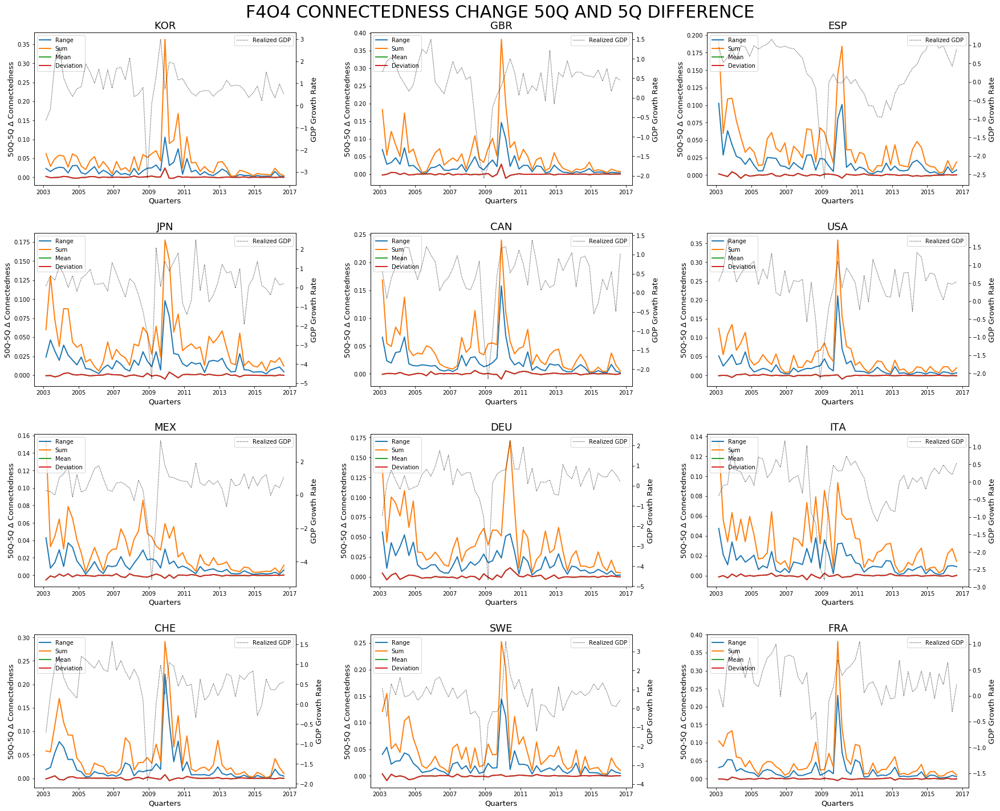

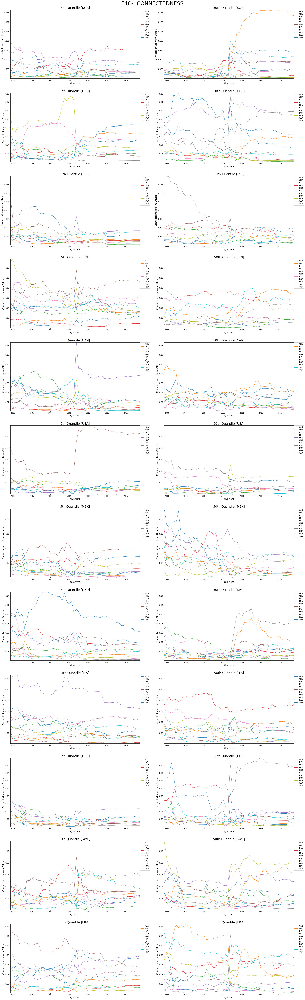

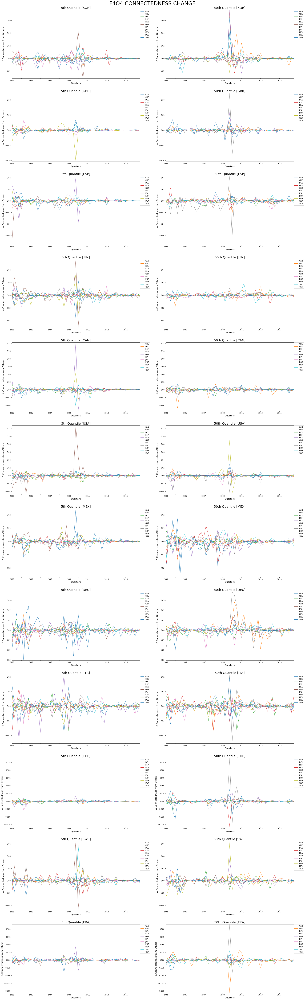

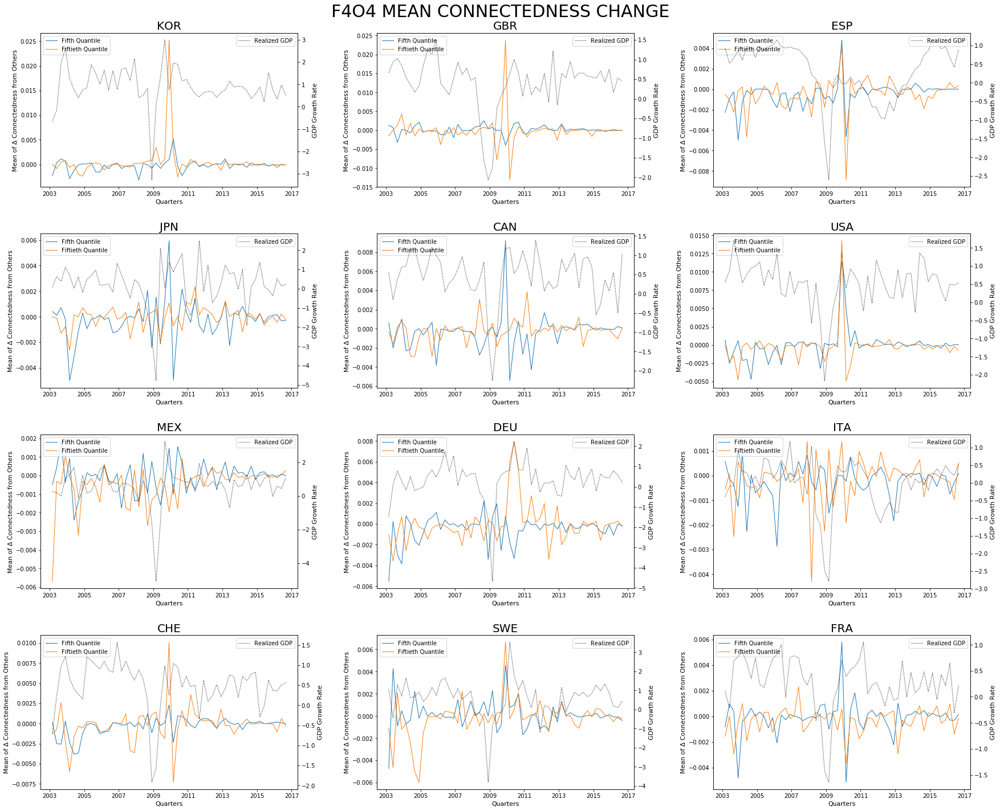

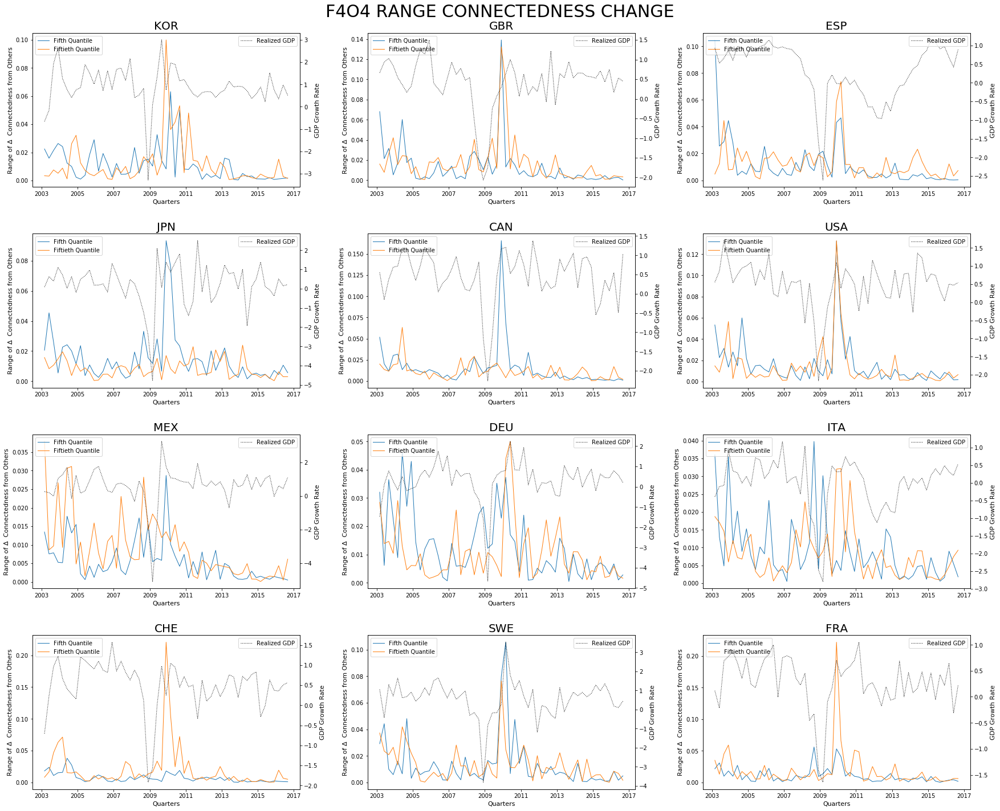

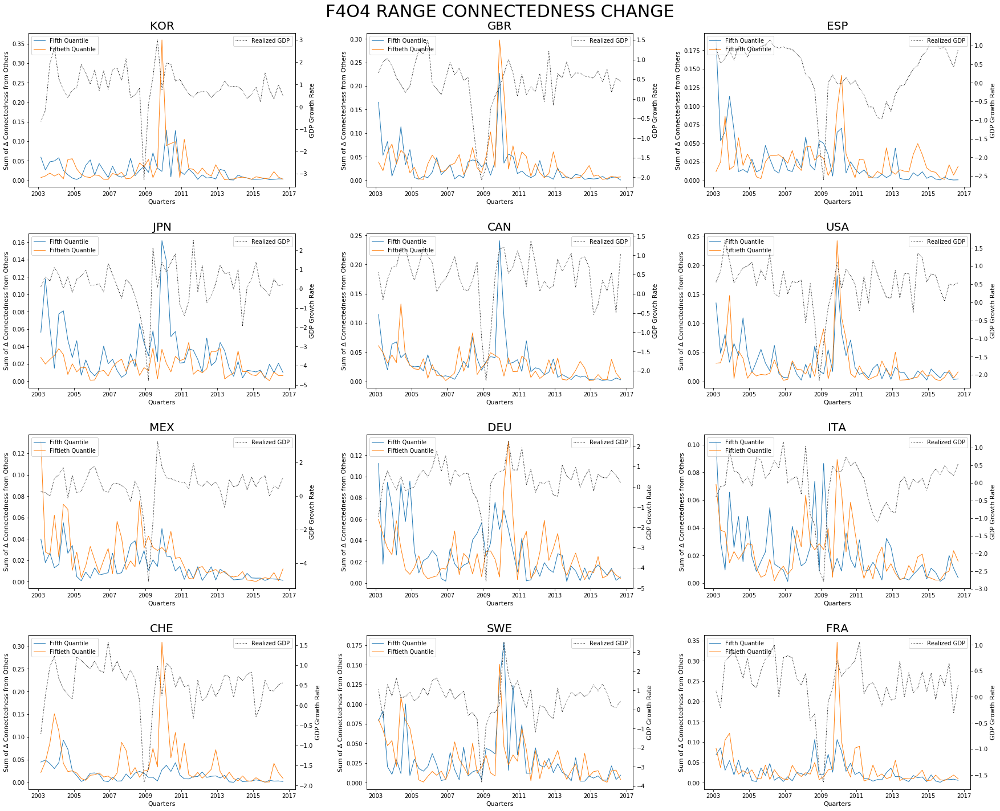

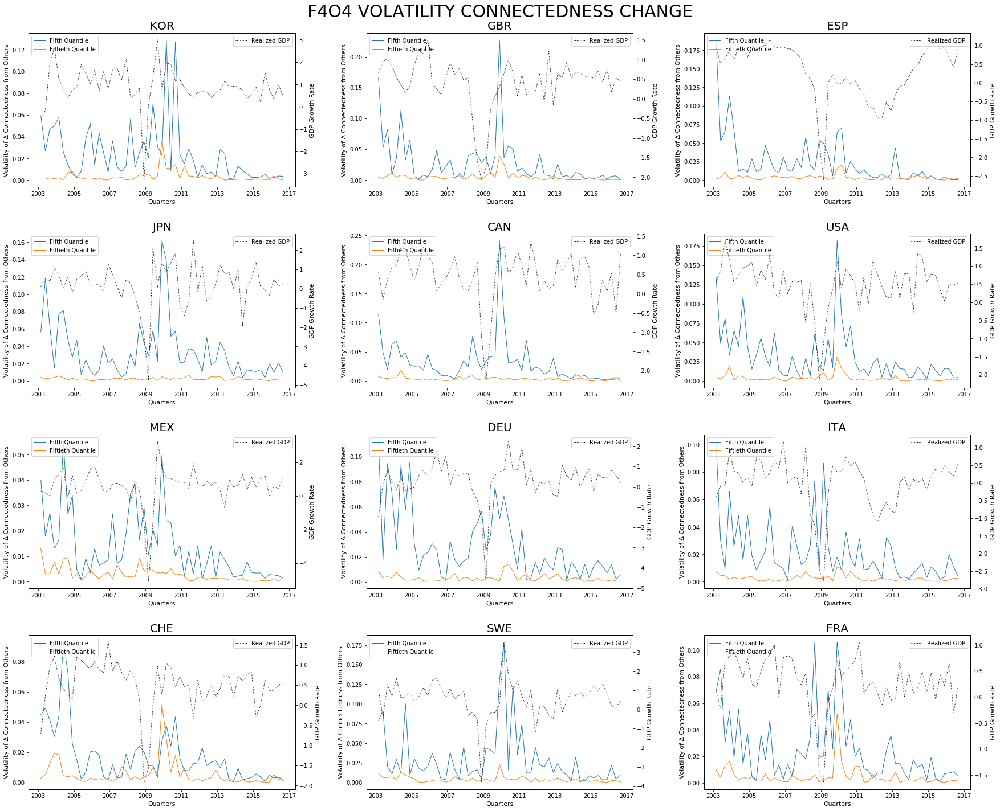

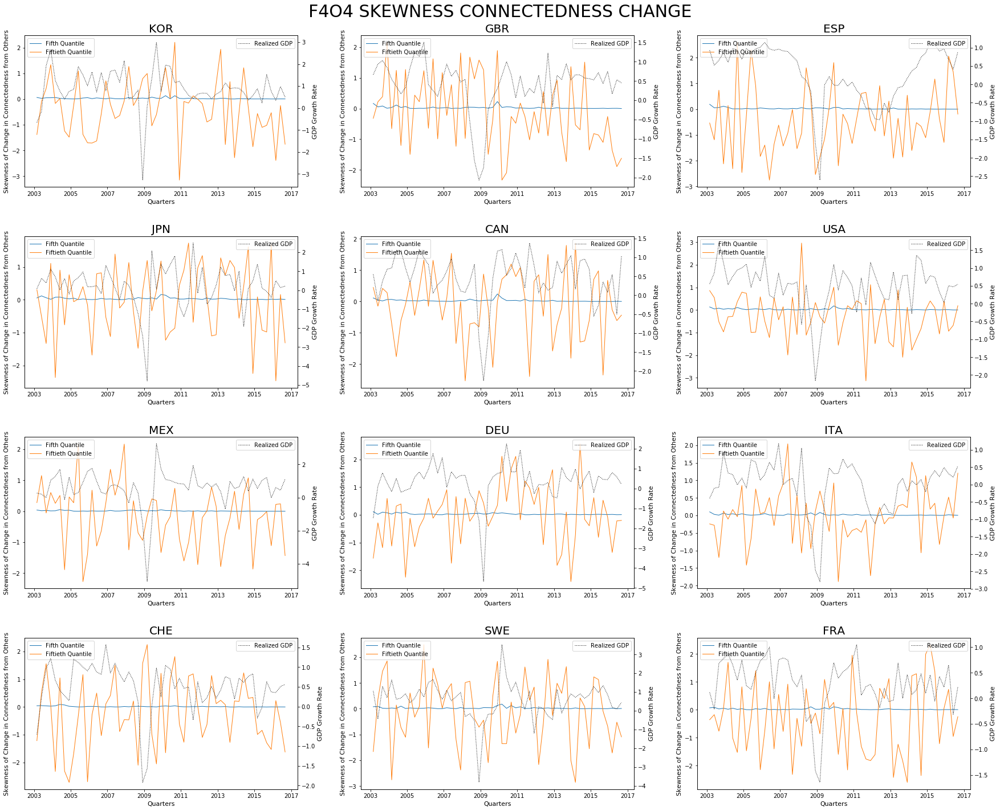

In [13]:
heatmap_comparison(net_5,net_50, 'F4O4_connectedness_heatmap_visualization')
plot_difference(net_5,net_50, gdp, u'50Q-5Q Connectedness', 'F4O4_connectedness_50q_and_5q_difference', instantaneous = False)
plot_difference(net_5,net_50, gdp, u'50Q-5Q Δ Connectedness', 'F4O4_connectedness_change_50q_and_5q_difference', instantaneous = True)
plot_net(net_5,net_50, u"Connectedness from Others", 'F4O4_connectedness', instantaneous = False)
plot_net(net_5,net_50, u"Δ Connectedness from Others", 'F4O4_connectedness_change', instantaneous = True)
plot_net_stats(net_5,net_50, gdp, u'Mean of Δ Connectedness from Others', 'F4O4_mean_connectedness_change', ptype = 'mean')
plot_net_stats(net_5,net_50, gdp, u'Range of Δ  Connectedness from Others', 'F4O4_range_connectedness_change', ptype = 'range')
plot_net_stats(net_5,net_50, gdp, u'Sum of Δ Connectedness from Others', 'F4O4_range_connectedness_change', ptype = 'sum')
plot_net_stats(net_5,net_50, gdp, u'Volatility of Δ Connectedness from Others', 'F4O4_volatility_connectedness_change', ptype = 'std')
plot_net_stats(net_5,net_50, gdp, u'Skewness of Change in Connectedness from Others', 'F4O4_skewness_connectedness_change', ptype = 'skew')
